### Experiment :
### Objectives

1. Train LSTM model
2. Train GRU model
3. Train Bidirectional model, with attention mechanism
4. Error analysis on each variant

### Observations

1. 
2. 
3. 

### Solutions and further investigation

1. 
2. 
3. 

### Load Modeules and datasets

In [1]:
import numpy as np
import random as rn
np.random.seed(0)
rn.seed(0)
import pandas as pd
import matplotlib.pyplot as plt
pd.set_option('display.max_colwidth', 1000)
# import helper function script
import sys
sys.path.insert(1,'G:\\Github\\Sinhala-Hate-Speech-Detection')
import utills
import TextClassifier


Instructions for updating:
non-resource variables are not supported in the long term


In [ ]:
def get_model(TC,model_type):
    from tensorflow.python.keras.models import Sequential
    from tensorflow.python.keras.optimizer_v2.adam import Adam
    from tensorflow.python.keras.layers import Dense,Input,SpatialDropout1D,Dropout,Flatten, SimpleRNN,LSTM,RNN,GRU,Bidirectional
    from tensorflow.python.keras.layers.embeddings import Embedding
    print("Build ML model")
    model = Sequential()
    model.add(Embedding(output_dim=TC.EMBEDDING_SIZE, 
                        input_dim=TC.LEN_VOCAB, 
                        input_length=TC.MAX_SEQ_LEN,
                        weights=[TC.emb_matrix], # Additionally we give the Wi
                        trainable=TC.trainable)) # Don't train the embeddings - just use GloVe embeddings
    # We can start with pre-trained embeddings and then fine-tune them using our data by setting trainable to True
    if(model_type=="RNN"):
        model.add(SimpleRNN(128, activation='relu',dropout=0.2, recurrent_dropout=0.3))
    elif(model_type == "LSTM"):
        model.add(LSTM(128, activation='relu',dropout=0.2, recurrent_dropout=0.2))
    elif(model_type == "GRU"):
        model.add(GRU(128, activation='relu',dropout=0.2, recurrent_dropout=0.3))
    elif(model_type == "BiLSTM"):
        model.add(Bidirectional(LSTM(128, activation='relu',dropout=0.2, recurrent_dropout=0.3,return_sequence=True)))
    elif(model_type == "BiGRU"):
        model.add(Bidirectional(GRU(128, activation='relu',dropout=0.2, recurrent_dropout=0.3,return_sequence=True)))
    model.add(Dropout(0.2))
    model.add(Dense(64, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(1,activation='sigmoid'))
    optimizer_adam = Adam(learning_rate=TC.lr)
    model.compile(loss='binary_crossentropy',
                optimizer=optimizer_adam,
                metrics=['acc'])
    print(model.summary())
    TC.model = model
    return model

In [ ]:
def build_model(TC):
    from tensorflow.python.keras.models import Sequential
    from tensorflow.python.keras.optimizer_v2.adam import Adam
    from tensorflow.python.keras.layers import Dense,Input,SpatialDropout1D,Dropout,Flatten, SimpleRNN,LSTM,RNN,GRU,Bidirectional,GlobalMaxPool1D,Conv1D
    from tensorflow.python.keras.layers.embeddings import Embedding
    model = Sequential()
    model.add(Embedding(output_dim=TC.EMBEDDING_SIZE, 
                        input_dim=TC.LEN_VOCAB, 
                        input_length=TC.MAX_SEQ_LEN,
                        weights=[TC.emb_matrix], # Additionally we give the Wi
                        trainable=TC.trainable)) # Don't train the embeddings - just use GloVe embedding
    model.add(SpatialDropout1D(0.3))
    model.add(Bidirectional(LSTM(128, dropout=0.2, recurrent_dropout=0.2, return_sequences=True)))
    model.add(Bidirectional(LSTM(128, dropout=0.2, recurrent_dropout=0.2, return_sequences=True)))
    model.add(Conv1D(64, 4))
    model.add(GlobalMaxPool1D())
    model.add(Dense(64, activation='relu'))
    model.add(Dense(1,activation='sigmoid'))
    optimizer_adam = Adam(learning_rate=TC.lr)
    model.compile(loss='binary_crossentropy',
                optimizer=optimizer_adam,
                metrics=['acc'])
    print(model.summary())
    TC.model = model
    return model

#### Fasttext

In [ ]:
TC_F = TextClassifier.TextClassifier(EMBEDDING='fasttext')

Load data

Build vocab

Load Embedding model

Create embedding index

found 818830 word vectors
Check coverage
Found embeddings for 86.04% of vocab
Found embeddings for  96.35% of all text
Added 3088 words to embedding with rare words handling of fasttext
Check coverage
Found embeddings for 100.00% of vocab
Found embeddings for  100.00% of all text
X train (4526,) Y train (4526,) X test (1940,) Y test (1940,)
dictionary size:  17577
Embedding matrix 



##### RNN

In [ ]:
TC_F.EPOCHS =50
TC_F.BATC_FH_SIZE =8
TC_F.lr = 0.00005
TC_F.tag = "RNN w2v-sg lr-0.00005"

rnn_model = TC_F.get_model("RNN")

Build ML model
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 100, 300)          6000000   
_________________________________________________________________
simple_rnn (SimpleRNN)       (None, 128)               54912     
_________________________________________________________________
dropout (Dropout)            (None, 128)               0         
_________________________________________________________________
dense (Dense)                (None, 64)                8256      
_________________________________________________________________
dropout_1 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 

In [ ]:
Y_pred = TC_F.model_evaluate(rnn_model,hist)
TC_F.save_predictions(Y_pred,TC_F.tag)

In [ ]:
error_analysis(TC_F,rnn_model,Y_pred)

##### GRU

In [ ]:
TC_F.EPOCHS =50
TC_F.BATC_FH_SIZE =8
TC_F.lr = 0.00005
TC_F.tag = "RNN w2v-sg lr-0.00005"
rnn_model = TC_F.get_model("RNN")
rnn_model, hist = TC_F.train_model(rnn_model)

Build ML model
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 100, 300)          6000000   
_________________________________________________________________
simple_rnn (SimpleRNN)       (None, 128)               54912     
_________________________________________________________________
dropout (Dropout)            (None, 128)               0         
_________________________________________________________________
dense (Dense)                (None, 64)                8256      
_________________________________________________________________
dropout_1 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 

In [ ]:
Y_pred = TC_F.model_evaluate(rnn_model,hist)
TC_F.save_predictions(Y_pred,TC_F.tag)

In [ ]:
error_analysis(TC_F,rnn_model,Y_pred)

##### LSTM

In [ ]:
TC_F.EPOCHS =50
TC_F.BATC_FH_SIZE =8
TC_F.lr = 0.00005
TC_F.tag = "RNN w2v-sg lr-0.00005"
rnn_model = TC_F.get_model("RNN")
rnn_model, hist = TC_F.train_model(rnn_model)

Build ML model
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 100, 300)          6000000   
_________________________________________________________________
simple_rnn (SimpleRNN)       (None, 128)               54912     
_________________________________________________________________
dropout (Dropout)            (None, 128)               0         
_________________________________________________________________
dense (Dense)                (None, 64)                8256      
_________________________________________________________________
dropout_1 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 

In [ ]:
Y_pred = TC_F.model_evaluate(rnn_model,hist)
TC_F.save_predictions(Y_pred,TC_F.tag)

In [ ]:
error_analysis(TC_F,rnn_model,Y_pred)

##### Bidirection LSTM

In [ ]:
TC_F.EPOCHS =50
TC_F.BATC_FH_SIZE =8
TC_F.lr = 0.00005
TC_F.tag = "RNN w2v-sg lr-0.00005"
rnn_model = TC_F.get_model("RNN")

rnn_model, hist = TC_F.train_model(rnn_model)

Build ML model
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 100, 300)          6000000   
_________________________________________________________________
simple_rnn (SimpleRNN)       (None, 128)               54912     
_________________________________________________________________
dropout (Dropout)            (None, 128)               0         
_________________________________________________________________
dense (Dense)                (None, 64)                8256      
_________________________________________________________________
dropout_1 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 

In [ ]:
Y_pred = TC_F.model_evaluate(rnn_model,hist)
TC_F.save_predictions(Y_pred,TC_F.tag)

In [ ]:
error_analysis(TC_F,rnn_model,Y_pred)

### Result and logging

In [10]:
def predict_proba(arr,TC=TC_F):
    import numpy as np
    from tensorflow.python.keras.preprocessing import sequence
    pred=TC.model.predict(sequence.pad_sequences(TC.token.texts_to_sequences(arr),maxlen=TC.MAX_SEQ_LEN))
    returnable=[]
    for i in pred:
        temp=i[0]
        returnable.append(np.array([1-temp,temp]))
    return np.array(returnable)


def error_analysis(TC,model,Y_pred):
    import numpy as np
    from IPython.display import display
    import matplotlib.pyplot as plt
    import eli5
    from eli5.lime import TextExplainer
    import shap
    from lime.lime_text import LimeTextExplainer
    import tensorflow.compat.v1 as tf
    tf.disable_v2_behavior()
    from tensorflow.python.keras.preprocessing import sequence

    import tensorflow.keras.backend as K
    #token = Tokenizer(num_words=self.LEN_VOCAB)
    #token.fit_on_texts(self.X_tr)
    lime_explainer= LimeTextExplainer(class_names=[0,1])

    te = TextExplainer(random_state=0)
    distrib_samples = TC.X_train[:100]
    explainer = shap.DeepExplainer(model, distrib_samples)
    # explain the first 25 predictions
    # explaining each prediction requires 2 * background dataset size runs
    num_explanations = 25 #len(TC_F.X_test)
    shap_values = explainer.shap_values(TC.X_test[:num_explanations])
    shap.initjs()
    num2word = {}
    arr_index=TC.X_te.index
    for w in TC.word_index.keys():
        num2word[TC.word_index[w]] = w
    x_test_words = np.stack([np.array(list(map(lambda x: num2word.get(x, "NONE"), TC.X_test[i]))) for i in range(num_explanations)])
    i=0
    
    for s in TC.X_te:
        if(i==21):
            break
        if(TC.Y_test[arr_index[i]] != Y_pred[i]):
            print(s)
            print("Predicted Label : ",TC.result_map(Y_pred[i])," | Turth Label : ",TC.result_map(TC.Y_test[arr_index[i]]))
            te.fit(TC.X_te[arr_index[i]],predict_proba)
            shap.force_plot(explainer.expected_value[0], shap_values[0][i], x_test_words[i],matplotlib=True)
            display(te.show_prediction(target_names=[0,1]))
            display(lime_explainer.explain_instance(TC.X_te[arr_index[i]],predict_proba).show_in_notebook(text=True))
        i+=1
        print()


ඕකගේ ලාච්චුවේ දාපල්ලා නරුමයා
Predicted Label :  Not Hate  | Turth Label :  Hate


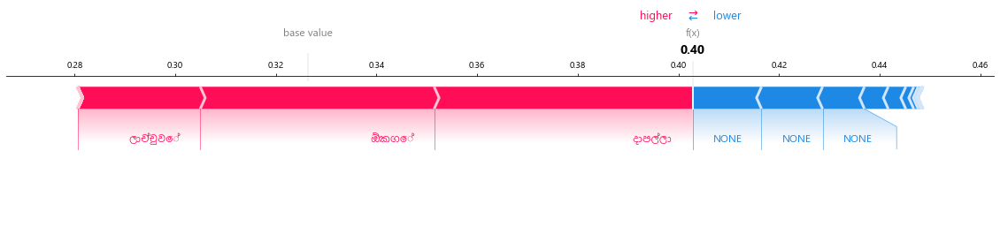

None



කෝටි න් ගියත් ත්‍රී වීල් එකෙන් ගියත් යන්නෙ එකම පාරෙ නෙ බං කවදාහරි දවසක ඕකත් දිරලා වල පල්ලට යනවා කෝටි කින් කරන්න තව වැඩ කොච්චර නම් තියේද
Predicted Label :  Not Hate  | Turth Label :  Hate


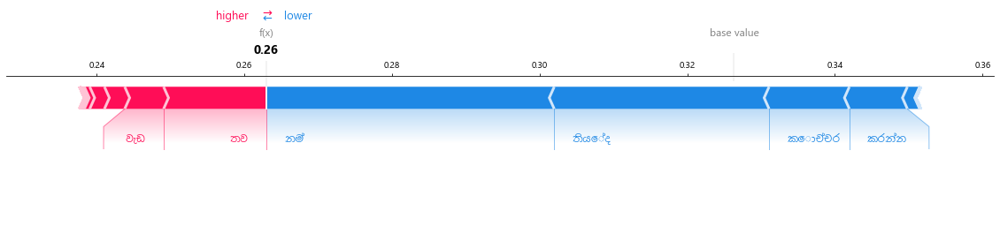

None


ඒකි හිතන් ඇත්තේ අපිට පුපේ ඉත්තෑවෝ දුවනව කියලද දන්නෑ ෆේක් වලින් හරි ගිහින් එව්ව බලන්න
Predicted Label :  Not Hate  | Turth Label :  Hate


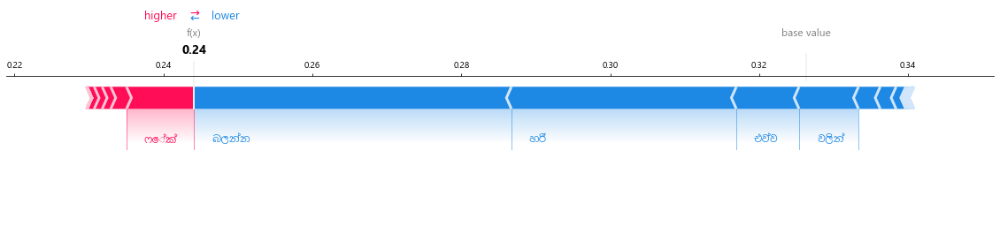

None


මේ තට්ටයව මුණ ගැහිලම විස්තරේ අහගනින් සියනෑවේ සිංහයා කියලා ඡන්දෙට ඉල්ලුවෙ සිංහයෙක් තියා හිවලෙක්වත් වෙන්න බෑ කියලා දැන් ඔප්පු වෙලා තියෙන්නෙ
Predicted Label :  Not Hate  | Turth Label :  Hate


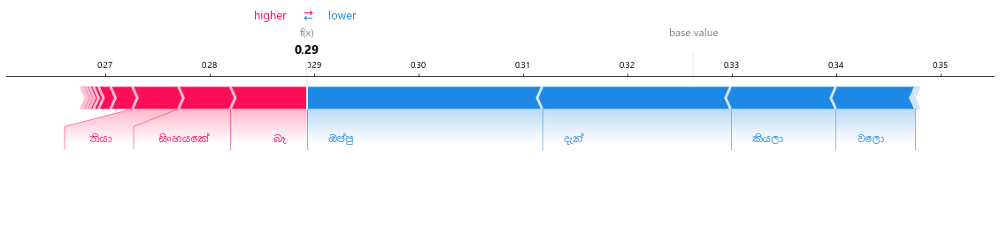

None


සිවුරක් දමාගැනීම දමිත් අසංක පුක පෙන්වීම පිදුරංගල වීරයෝ සෙට් එකම එකම සෙල් එකට සෙට් උනොත් සිංදු කිය කිය පුක පෙන්නතැකි
Predicted Label :  Hate  | Turth Label :  Not Hate


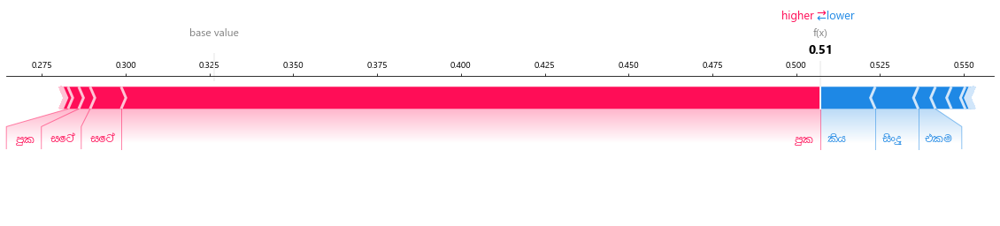

None


උඹ දේශපාලන පලිගැනීම් ගැන දන්නෙම නැති තොත්ත බබා හොදම වැඩේ උඹට කවදාහරි කරෝල වෙලා විදවලාම මැරියං
Predicted Label :  Not Hate  | Turth Label :  Hate


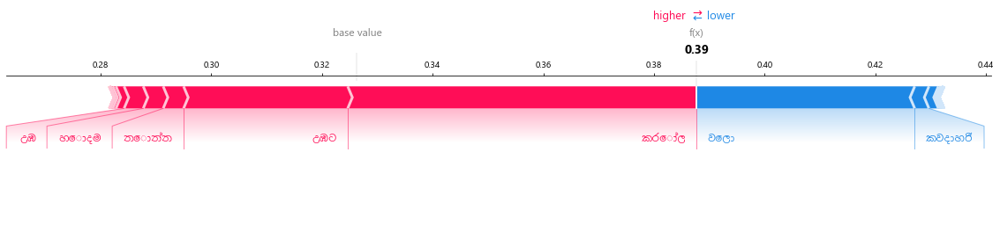

None



අනේ පලයන් බොල බොරු නොකියා නොදන්න මිනිහෙක් ඇවිල්ලා ප්‍රශ්න අහනකොට මේ වගේ උත්තර දෙනවද උන් මේවා කියපන් කොන්ඩෙ බැදපු චීනෙක්ට
Predicted Label :  Not Hate  | Turth Label :  Hate


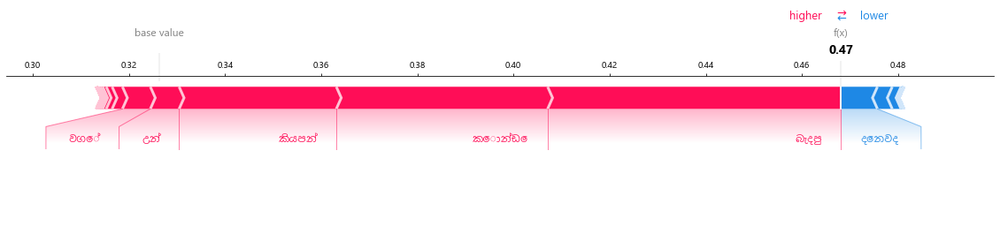

None





ලොරි ඩ්‍රයිවර්ලා ඔක්කොම ඔහොම මෝඩ වැඩ තමය් කරන්නේ ඒගොල්ලන් ඉගනගැන නැති හින්ද නේ ඩ්‍රයිවර් කෙනෙක් වෙන්නේ
Predicted Label :  Not Hate  | Turth Label :  Hate


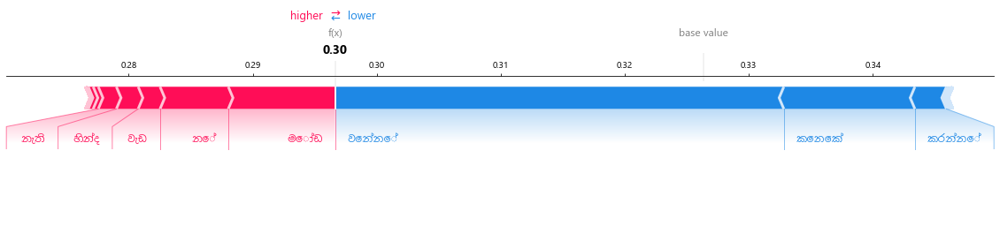

None


අනේ උබ මඩ ගහන්න දන්නෙම නැති එකා සංගිලි විමලයා කියන්නේ තනිකර කක්කුස්සි කටක් තියෙන උගත් කමක් නැති ගවයෙක්ට
Predicted Label :  Not Hate  | Turth Label :  Hate


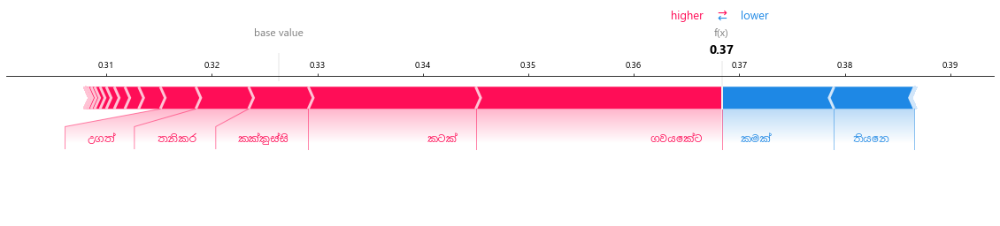

None




මේවට හිනා වෙන්න ඕනෙ යකෝ අධෝ මුඛයෙන් මේ වගේ නාකියෙක් බැදගෙන මදිවට මේකි කියන පුරසාරම් ඇහුවම අපි කුඩු ගහලද නැත්තං මේකි කුඩු ගහලද කියලා හිතෙනවා
Predicted Label :  Not Hate  | Turth Label :  Hate


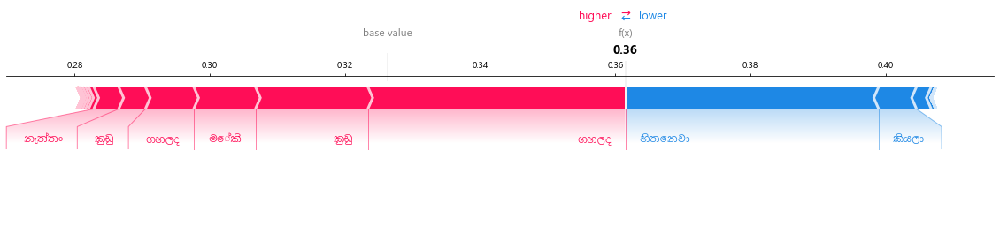

None



තෝ ඉගෙන ගත්තේ නැති නිසා තමයි සුද්දගේ කක්කුස්සි හොදන්නේ ඔහෙට වෙලා වැඩක් නැත්තන් කක්කුස්සි වලක් හාරගෙන කාපිය සූකරයා
Predicted Label :  Not Hate  | Turth Label :  Hate


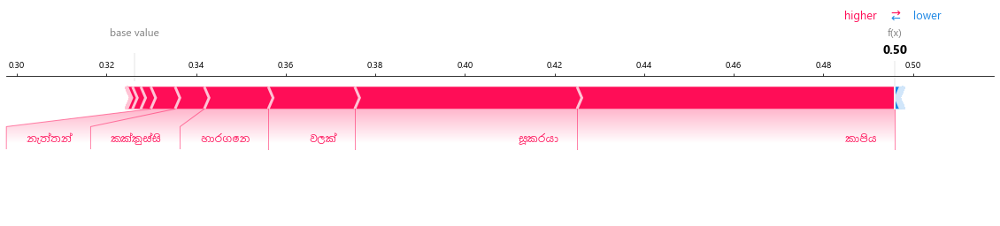

None

Unexpected error in ping thread.
Traceback (most recent call last):
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 672, in urlopen
    chunked=chunked,
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 421, in _make_request
    six.raise_from(e, None)
  File "<string>", line 3, in raise_from
  File "C:\Users\Kavishka\anaconda3\lib\site-packages\urllib3\connectionpool.py", line 416, in _make_request
    httplib_response = conn.getresponse()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 1344, in getresponse
    response.begin()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 306, in begin
    version, status, reason = self._read_status()
  File "C:\Users\Kavishka\anaconda3\lib\http\client.py", line 267, in _read_status
    line = str(self.fp.readline(_MAXLINE + 1), "iso-8859-1")
  File "C:\Users\Kavishka\anaconda3\lib\socket.py", line 589, in readinto
    return self._sock.recv_into

In [ ]:
# error_analysis(TC_F,rnn_model,Y_pred)